# TRABAJO FINAL INTEGRADOR

### NOMBRE: GUIDO PETTINARI

### TUTOR: VALERIA SOLIANI

### UNIVERSIDAD: INSTITUTO TECNOLOGICO DE BUENOS AIRES (ITBA)

**El Trabajo se dividirá en**:

    1) Análisis Exploratorio Descriptivo
    2) Feature Engineering o Preparación de Datos
    3) Modelos Predictivos: Probaremos diferentes algoritmos predictivos

### Import Libraries

In [1]:
import pandas as pd
from funpymodeling.exploratory import status, profiling_num, freq_tbl, cat_vars, num_vars, corr_pair
from pandas_profiling import ProfileReport
from qgrid import show_grid
import matplotlib.pyplot as plt
import seaborn as sns


### Load Dataframe

In [2]:
data = pd.read_csv('dataset_hr.csv', sep=',')

### 1) Estado de salud del Dataframe

In [3]:
# Mostramos las primeras 20 filas del dataset
show_grid(data.head(20), grid_options={'forceFitColumns': False, 'defaultColumnWidth': 200})

QgridWidget(grid_options={'fullWidthRows': True, 'syncColumnCellResize': True, 'forceFitColumns': False, 'defa…

In [4]:
### Cantidad de datos
print("Cantidad de filas = " + str(len(data)))

# Analizamos cuantos valores nulos, cuantas variables nulas, cuantos valores unicos
status_data = status(data)
print('Variables Categoricas = '+ str(status_data[status_data['type'] == 'object']['type'].count()))
print('Variables Numéricas = ' + str(status_data[status_data['type'] != 'object']['type'].count()))
status(data)

Cantidad de filas = 1470
Variables Categoricas = 9
Variables Numéricas = 26


,variable,q_nan,p_nan,q_zeros,p_zeros,unique,type
0,Age,0,0.0,0,0.000000,43,int64
1,Attrition,0,0.0,0,0.000000,2,object
2,BusinessTravel,0,0.0,0,0.000000,3,object
3,DailyRate,0,0.0,0,0.000000,886,int64
4,Department,0,0.0,0,0.000000,3,object
5,DistanceFromHome,0,0.0,0,0.000000,29,int64
6,Education,0,0.0,0,0.000000,5,int64
7,EducationField,0,0.0,0,0.000000,6,object
8,EmployeeCount,0,0.0,0,0.000000,1,int64
9,EmployeeNumber,0,0.0,0,0.000000,1470,int64


### Primeras conclusiones:

1) El dataset cuenta con 1470 filas donde cada fila es un empleado .\
2) Son 35 variables, de las cuales hay 26 variables numéricas y 9 variables categóricas. Teniendo como variable a predecir "Monthly Income"\
3) Observaciones: 
- **Datos Nulos**: No hay variables que tengan datos nulos.
- **Valores igual a 0**: Las siguientes Variables tienen valores = a cero:
    - Num. Companies Worked: 197 valores. Es posible que haya empleados que no hayan trabajado en otra empresa (suponiendo que la empresa actual no es contabilizada sino sería incorrecto el cero)
    - Stock Option Level: 631 valores
    - Total Working Years: 11 valores. Puede ser que haya empleados que tengan menos de 1 año trabajando
    - Training Times Last Year: 54 valores. Puede ser que haya empleados que tengan menos de 1 año trabajando
    - Years at Company: 44 valores. Puede ser que haya un 2% de empleados con menos de 1 año trabajando en la cia.
    - Years in Current Role: 244 valores. Puede ser que haya empleados con menos de 1 año en el actual puesto
    - Years Since Last Promotion: 581 valores. Se podría inferir que de los 1470 empleados, 581 (el 40%) fueron promocionados hace menos de un año
    - Years with current manager: 263 valores.
- **Cardinalidad**: (Aquellos que tienen más de 30/40 valores unicos) Tanto Age, Total Working Years, Years at Company, Hourly Rate, Daily Rate, Monthly Rate y Monthly Income son datos que tienen alta cardinalidad



### 2) Análisis Univariado Variables Numéricas

#### Distribuciones

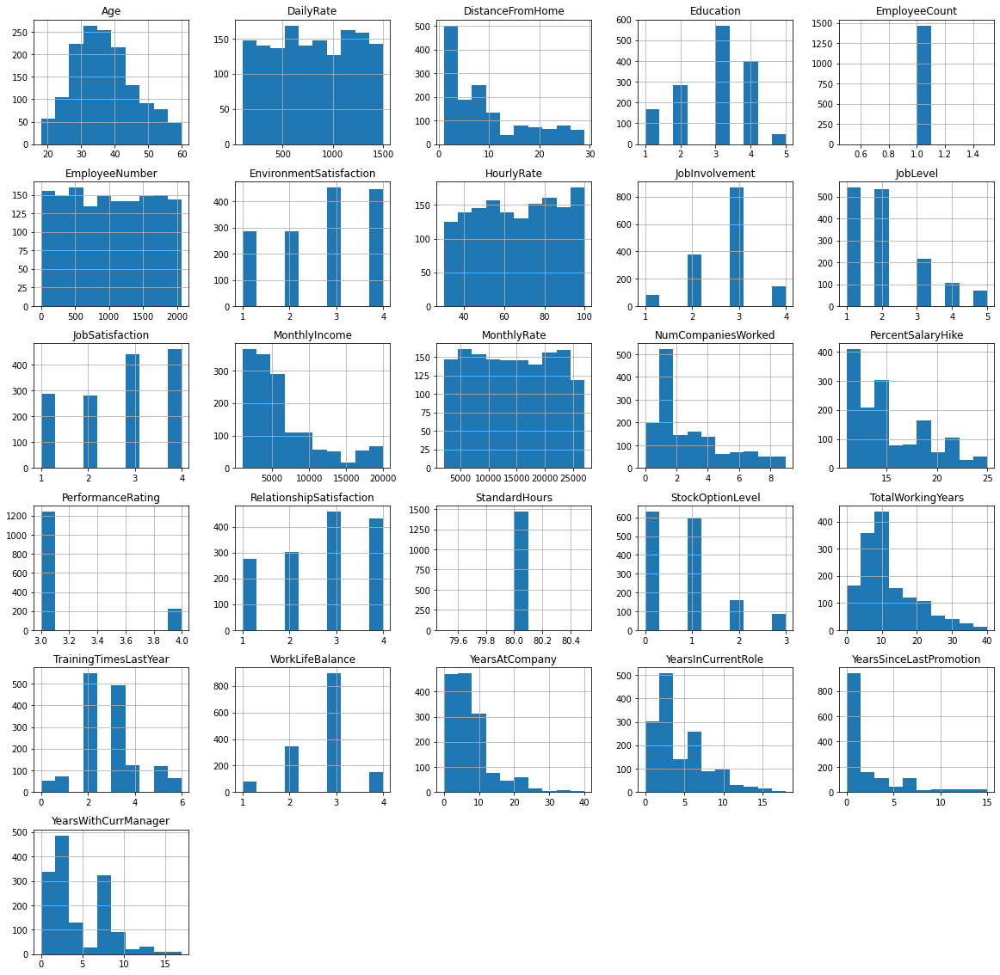

In [5]:
data.hist(figsize = (20,20));

**Observaciones distribuciones**:
- Age: La edad tiene una distribución normal y va desde 20 a 60 años
- Distance From Home: La distribución tiene cierta asimetría donde la mayoría de los empleados están entre 0 y 10 millas de distancia de la oficina
- Tanto en Years since last Promotion, Total Working Years y Years at company podríamos llegar a encontrar algunos outliers a verificar más adelante
- Education tiene valores numéricos pero deberíamos convertirla a categorica para algunos algoritmos. Lo mismo sucede con work life balance, environment satisfaction, job level, job involvment, job level, job satisfaction. En estos casos no tenddría sentido que uno es menor que el otro.

In [6]:
profiling_num(data).round(6)

,variable,mean,std_dev,variation_coef,p_0.01,p_0.05,p_0.25,p_0.5,p_0.75,p_0.95,p_0.99
0,Age,36.923810,9.135373,0.247411,19.00,24.00,30.00,36.0,43.00,54.00,58.31
1,DailyRate,802.485714,403.509100,0.502824,117.00,165.35,465.00,802.0,1157.00,1424.10,1485.00
2,DistanceFromHome,9.192517,8.106864,0.881898,1.00,1.00,2.00,7.0,14.00,26.00,29.00
3,Education,2.912925,1.024165,0.351593,1.00,1.00,2.00,3.0,4.00,4.00,5.00
4,EmployeeCount,1.000000,0.000000,0.000000,1.00,1.00,1.00,1.0,1.00,1.00,1.00
5,EmployeeNumber,1024.865306,602.024335,0.587418,19.69,96.45,491.25,1020.5,1555.75,1967.55,2046.62
6,EnvironmentSatisfaction,2.721769,1.093082,0.401607,1.00,1.00,2.00,3.0,4.00,4.00,4.00
7,HourlyRate,65.891156,20.329428,0.308530,30.00,33.00,48.00,66.0,83.75,97.00,100.00
8,JobInvolvement,2.729932,0.711561,0.260652,1.00,1.00,2.00,3.0,3.00,4.00,4.00
9,JobLevel,2.063946,1.106940,0.536322,1.00,1.00,1.00,2.0,3.00,4.00,5.00


#### Observaciones profiling_num

- Coeficiente de Variación (Desvío Estandar / Promedio): Esto nos va a decir la probabilidad de que esa variable contenga outliers. Cuanto más grande es dicho número máyor es la probabilidad de que aya outliers. Como vemos todas las variables están cercanas a 0 por lo que rectificando lo que dijimos en el punto anterior el coeficiente de variación nos dice que hay probabilidades de que no haya outliers.

#### Outliers

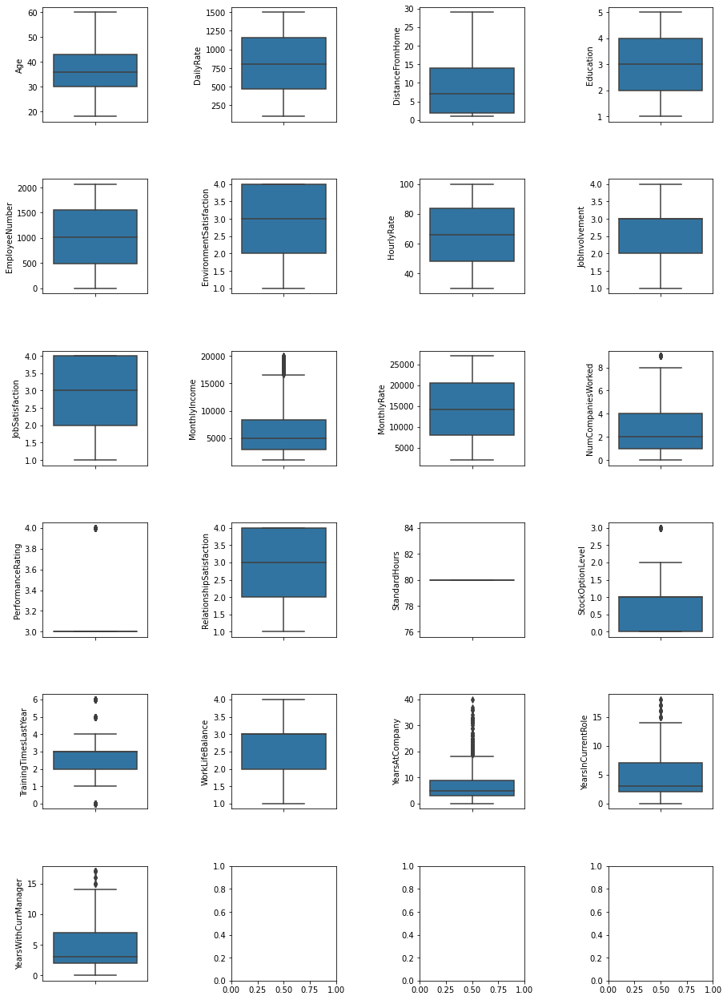

In [7]:

#Tamaño de las figuras
fig, axes= plt.subplots(nrows=6, ncols=4,figsize=(15,9))

#Distancia entre cada figura
plt.subplots_adjust(left=None, bottom=None, right=None, top=2, wspace=0.8, hspace=0.5)


# Primera fila de graficos
j = 0
h = 0
for i in num_vars(data):
    if j < 4:
        sns.boxplot(x=i,
                    data=data,orient = 'v',ax=axes[h,j])
        j = j + 1
    else:
        j = 0
        h = h + 1

#### Observaciones

- Correlaciones: En Monthly Income, Years at company, Training times last year, Years with current manager, years with current role contienen outliers que luego deberemos analizar que procedimiento realizar a la hora de desarrollar los diferentes algoritmos predictivos

### 3) Análisis univariado variables categóricas

#### Análisis cuantitativo de las variables categóricas

In [8]:
freq_tbl(data)

  Attrition  frequency  percentage  cumulative_perc
0        No       1233    0.838776         0.838776
1       Yes        237    0.161224         1.000000

----------------------------------------------------------------

      BusinessTravel  frequency  percentage  cumulative_perc
0      Travel_Rarely       1043    0.709524         0.709524
1  Travel_Frequently        277    0.188435         0.897959
2         Non-Travel        150    0.102041         1.000000

----------------------------------------------------------------

               Department  frequency  percentage  cumulative_perc
0  Research & Development        961    0.653741         0.653741
1                   Sales        446    0.303401         0.957143
2         Human Resources         63    0.042857         1.000000

----------------------------------------------------------------

     EducationField  frequency  percentage  cumulative_perc
0     Life Sciences        606    0.412245         0.412245
1           Med

#### Conclusiones Análisis cuantitativo

- Hay un bajo nivel de personas que dejaron la empresa con respecto a las que sigeun.Es decir, 16% (237) la han dejado
- Hay un bajo nivel de personas pertenecientes al sector de recursos humanos (0.04%, 63) con respecto a los otros dos sectores. Lo mismo sucede en Education Field para los valores Technical Degree, Other y Human Resources.


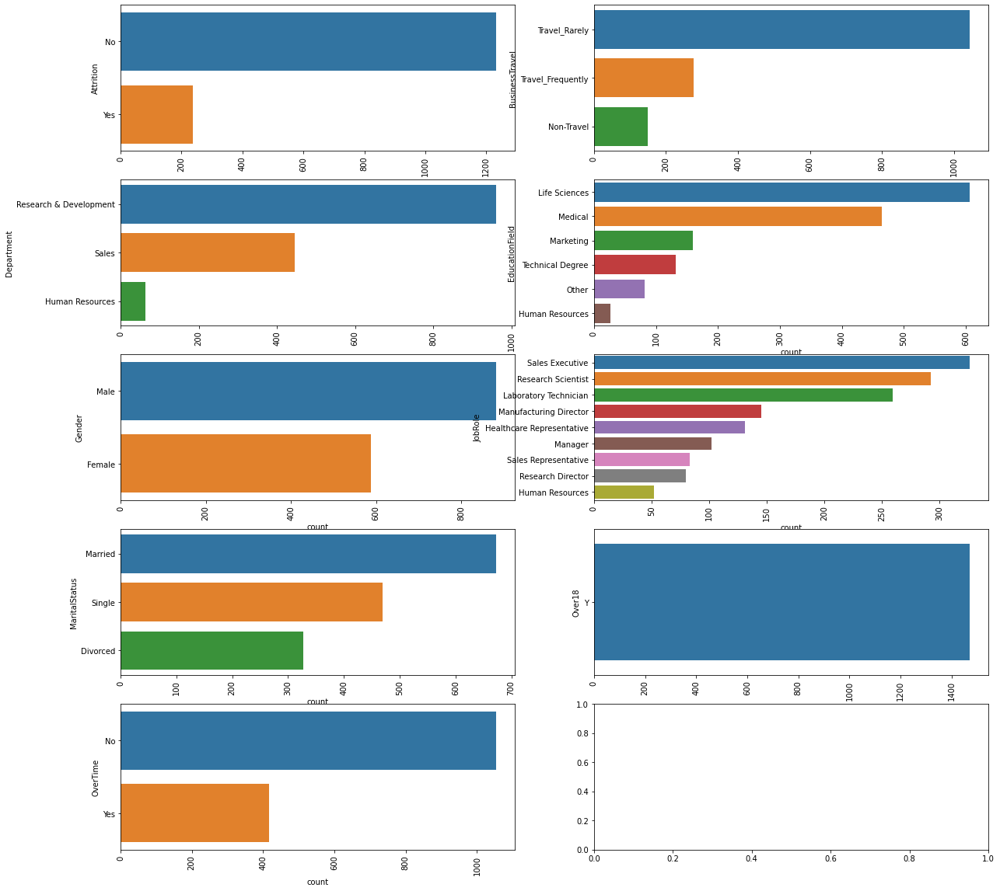

In [9]:

#Va a imprimir por cada variable como aparece cada categoría
d_plot=data
fig, ax = plt.subplots(5, 2, figsize=(20, 20))
for variable, subplot in zip(cat_vars(d_plot), ax.flatten()):
    sns.countplot(y=d_plot[variable], ax=subplot, order = d_plot[variable].value_counts().index)
    for label in subplot.get_xticklabels():
        label.set_rotation(90)


### 4) Exploración con pandas profiling

In [10]:
ProfileReport(data)

### Observaciones

1) Employee Count: Es un valor constante resultante de la cuenta de la cantidad de empleados. Es una variable que deberíamos borrar a la hora de desarrollar nuestros algoritmos\
2) Employee Number: Es el id por lo que tiene 1470 valores distintos. Deberíamos también no tenerla en cuenta a la hora de desarrollar nuestros algoritmos\
3) Over 18: Variable constante que podríamos no tener en cuenta\
4) Standard Hours: Variable constante por lo que podríamos no tenerla en cuenta\
5) Years since last promotion: Un 39% de los datos tiene 0 \

### 5) Análisis Bivariado

#### Análisis categóricas vs numérica

Entendiendo que nuestra variable Y es una variable numérica vamos a comparar nuestras variables categóricas vs la misma

In [11]:
for i in cat_vars(data):
    display(data.groupby(i)['MonthlyIncome'].describe().sort_values(by='mean',ascending=False))
    print('-------------------------')

,count,mean,std,min,25%,50%,75%,max
Attrition,,,,,,,,
No,1233.0,6832.739659,4818.208001,1051.0,3211.0,5204.0,8834.0,19999.0
Yes,237.0,4787.092827,3640.210367,1009.0,2373.0,3202.0,5916.0,19859.0


-------------------------


,count,mean,std,min,25%,50%,75%,max
BusinessTravel,,,,,,,,
Travel_Rarely,1043.0,6619.707574,4821.853698,1009.0,2930.5,4960.0,8421.00,19999.0
Non-Travel,150.0,6261.946667,4493.415018,1051.0,2998.0,4973.5,7423.25,19973.0
Travel_Frequently,277.0,6193.725632,4371.990442,1091.0,2853.0,4735.0,7918.00,19847.0


-------------------------


,count,mean,std,min,25%,50%,75%,max
Department,,,,,,,,
Sales,446.0,6959.172646,4058.739322,1052.0,4446.25,5754.5,8776.75,19847.0
Human Resources,63.0,6654.507937,5788.732921,1555.0,2644.00,3886.0,8412.50,19717.0
Research & Development,961.0,6281.252862,4895.835087,1009.0,2741.00,4374.0,7655.00,19999.0


-------------------------


,count,mean,std,min,25%,50%,75%,max
EducationField,,,,,,,,
Marketing,159.0,7348.584906,4204.250368,1675.0,4591.00,6118.0,9259.50,19845.0
Human Resources,27.0,7241.148148,6444.154499,1555.0,2463.50,3886.0,8190.00,19636.0
Medical,464.0,6510.036638,4906.371796,1009.0,2815.25,4722.0,8401.50,19859.0
Life Sciences,606.0,6463.288779,4715.485900,1051.0,2865.25,4943.0,8143.75,19999.0
Other,82.0,6071.548780,4481.234203,1951.0,3075.00,4561.0,6924.25,19613.0
Technical Degree,132.0,5758.303030,4139.770625,1091.0,2583.50,4318.0,7165.25,19943.0


-------------------------


,count,mean,std,min,25%,50%,75%,max
Gender,,,,,,,,
Female,588.0,6686.566327,4695.608507,1129.0,3037.0,5081.5,8711.75,19973.0
Male,882.0,6380.507937,4714.856577,1009.0,2819.5,4837.5,8113.75,19999.0


-------------------------


,count,mean,std,min,25%,50%,75%,max
JobRole,,,,,,,,
Manager,102.0,17181.676471,2317.199822,11244.0,16339.50,17454.5,19129.25,19999.0
Research Director,80.0,16033.550000,2827.621369,11031.0,13490.25,16510.0,18814.50,19973.0
Healthcare Representative,131.0,7528.763359,2542.550170,4000.0,5562.00,6811.0,9769.50,13966.0
Manufacturing Director,145.0,7295.137931,2676.745753,4011.0,5070.00,6447.0,9526.00,13973.0
Sales Executive,326.0,6924.279141,2366.943019,4001.0,5025.25,6231.0,8538.75,13872.0
Human Resources,52.0,4235.750000,2438.849744,1555.0,2340.25,3093.0,5803.50,10725.0
Research Scientist,292.0,3239.972603,1198.116113,1009.0,2386.00,2887.5,3902.50,9724.0
Laboratory Technician,259.0,3237.169884,1150.249802,1102.0,2379.50,2886.0,3880.50,7403.0
Sales Representative,83.0,2626.000000,854.534419,1052.0,2250.00,2579.0,2878.50,6632.0


-------------------------


,count,mean,std,min,25%,50%,75%,max
MaritalStatus,,,,,,,,
Married,673.0,6793.671620,4859.686276,1052.0,3022.0,5204.0,9069.00,19999.0
Divorced,327.0,6786.287462,4845.647590,1129.0,3015.0,5131.0,9417.50,19973.0
Single,470.0,5889.472340,4325.571133,1009.0,2722.0,4536.0,7328.25,19926.0


-------------------------


,count,mean,std,min,25%,50%,75%,max
Over18,,,,,,,,
Y,1470.0,6502.931293,4707.956783,1009.0,2911.0,4919.0,8379.0,19999.0


-------------------------


,count,mean,std,min,25%,50%,75%,max
OverTime,,,,,,,,
Yes,416.0,6548.548077,4675.293789,1009.0,2883.25,5061.5,8396.5,19859.0
No,1054.0,6484.926945,4722.875102,1051.0,2930.75,4880.0,8368.5,19999.0


-------------------------


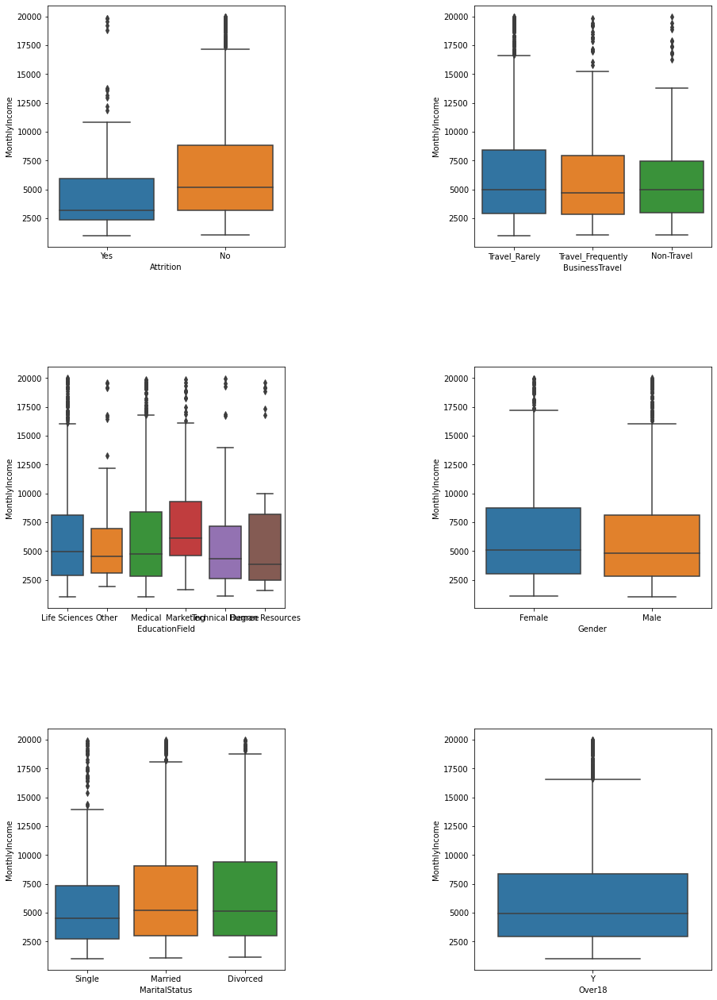

In [12]:
#Tamaño de las figuras
fig, axes= plt.subplots(nrows=3, ncols=2,figsize=(15,9))

#Distancia entre cada figura
plt.subplots_adjust(left=None, bottom=None, right=None, top=2, wspace=0.8, hspace=0.5)


# Primera fila de graficos
j = 0
h = 0
for i in cat_vars(data):
    if j < 2:
        sns.boxplot(x=i, y=data["MonthlyIncome"],
                    data=data,orient = 'v',ax=axes[h,j])
        j = j + 1
    else:
        j = 0
        h = h + 1

#### Observaciones:

El gráfico de boxplots no sirve para verificar que tenemos varios outliers los cuales dependiendo el algoritmo vamos a tener que tener cuidado con estos valores y o bien realizar algún tipo de manipulación del dato en dicho momento o bien dejarlo como está.

#### Análisis numérica vs numérica -> Correlaciones

A continuación vamos a realizar un correlagrama para analizar la correlación entre variables

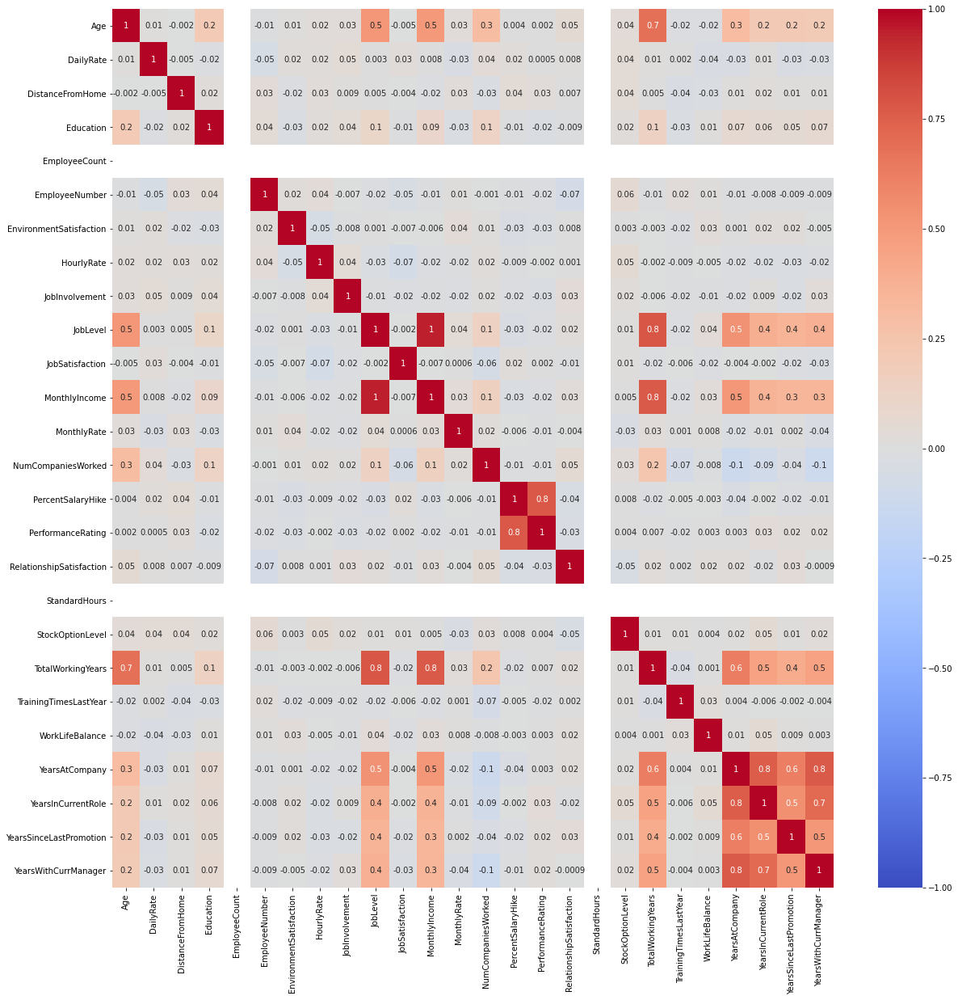

In [13]:

numeric = num_vars(data)
data_numeric = data[numeric]

fig, ax = plt.subplots(figsize=(20,20)) 
corr = data.corr()
sns.heatmap(corr, annot = True, fmt='.1g', vmin=-1, vmax=1, center= 0, cmap= 'coolwarm', ax=ax)

    
plt.show()

In [19]:
correlaciones = corr_pair(data)
correlaciones['v1andv2'] = correlaciones['v1'] + ' - ' + correlaciones['v2']
show_grid(correlaciones[['v1andv2','R','R2']])

QgridWidget(grid_options={'fullWidthRows': True, 'syncColumnCellResize': True, 'forceFitColumns': True, 'defau…

#### Observaciones correlaciones

- Podemos encontrar que hay varias variables que tienen una fuerte correlación. Entre ellas una correlación fuerte entre las siguientes variables:
    - Monthly Income y Job Level (0,95)
    - Job Level y Total Working Years (0,95)
    - Performance Rating y Percent Salary Hike (0,77)
    - Monthly Income y Total Working Years
    - Years at Company y Years with Current manager
    - Years in Current Role y Years at Compnay
    - Age y Total Working Role

#### Correlación variables categoricas


In [15]:
### Aplicamos one hot encoding

data_ohe = pd.get_dummies(data,drop_first=True,dummy_na=True)

### Elimino aquellas variables con valor unico 1 (constantes)

vars_to_drop = status(data_ohe).query("unique==1")['variable']
data_ohe=data_ohe.drop(vars_to_drop,axis=1)

In [16]:
correlaciones = corr_pair(data_ohe)
show_grid(correlaciones)

QgridWidget(grid_options={'fullWidthRows': True, 'syncColumnCellResize': True, 'forceFitColumns': True, 'defau…

#### Observaciones

No encontramos correlaciones cuando pasamos a numerica las variables categoricas por medio de one hot encoding

- En base a las correlaciones luego se van a realizar combinaciones quitando una de las dos variables altamente correlacionadas